In [21]:
import phate
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from  Data_Selection import *
import seaborn as sns

In [2]:
# Load CSV into a DataFrame
file = 'df_main.csv'
data = pd.read_csv(file)

# Display the first few rows of the data
print(data.head())

   cellidx      TBX6       BRA      CDX2      SOX2      SOX1  \
0        0  0.541198  0.228724  1.136731  2.638387  0.676792   
1        1  0.562709  0.153176  1.251472  0.776583  0.694261   
2        2  0.637590  0.240679  1.486664  3.752942  0.682324   
3        3  0.640359  0.184531  1.614646  4.068103  0.828319   
4        4  0.639919  0.153728  1.823096  2.079683  0.990685   

                   filename  timepoint  sample  
0  D2.5_A2_A02_003.fcs .csv        2.5       0  
1  D2.5_A2_A02_003.fcs .csv        2.5       0  
2  D2.5_A2_A02_003.fcs .csv        2.5       0  
3  D2.5_A2_A02_003.fcs .csv        2.5       0  
4  D2.5_A2_A02_003.fcs .csv        2.5       0  


In [3]:
selected_data, combined_equal_data  = data_selector(7200, file)

In [4]:
print(selected_data)
print(combined_equal_data)

           TBX6       BRA      CDX2      SOX2      SOX1
0      0.712941  0.245024  1.804050  2.118150  0.748812
1      0.396271  0.123065  1.012057  2.676406  0.521711
2      0.647942  0.200438  1.300215  5.706961  0.646797
3      0.425355  0.157897  0.854942  1.748533  0.441205
4      0.381848  0.096692  0.729118  0.508345  0.481436
...         ...       ...       ...       ...       ...
50395  2.393723  0.187909  0.719677  0.206253  0.811701
50396  0.722864  0.448907  1.494106  4.268627  1.728922
50397  0.599488  0.364155  2.854191  1.081338  1.334845
50398  0.708004  0.285362  0.973050  0.354309  0.953656
50399  0.454967  0.262575  0.664267  0.188191  0.667618

[50400 rows x 5 columns]
           TBX6       BRA      CDX2      SOX2      SOX1  timepoint  sample
0      0.712941  0.245024  1.804050  2.118150  0.748812        2.0       2
1      0.396271  0.123065  1.012057  2.676406  0.521711        2.0       2
2      0.647942  0.200438  1.300215  5.706961  0.646797        2.0       2
3 

In [5]:
phate_op = phate.PHATE()
data_phate = phate_op.fit_transform(selected_data)

Calculating PHATE...
  Running PHATE on 50400 observations and 5 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 3.51 seconds.
    Calculating affinities...
    Calculated affinities in 0.13 seconds.
  Calculated graph and diffusion operator in 3.66 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 3.14 seconds.
    Calculating KMeans...
    Calculated KMeans in 3.38 seconds.
  Calculated landmark operator in 7.37 seconds.
  Calculating optimal t...
    Automatically selected t = 32
  Calculated optimal t in 3.24 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.63 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 2.38 seconds.
Calculated PHATE in 17.28 seconds.


In [6]:
print(data_phate)
print(len(data_phate))

[[-0.00681257 -0.01237965]
 [-0.02621316 -0.01755402]
 [-0.0164122   0.01871174]
 ...
 [ 0.00665376  0.00169496]
 [ 0.01947676 -0.01118702]
 [ 0.0215473  -0.01851361]]
50400


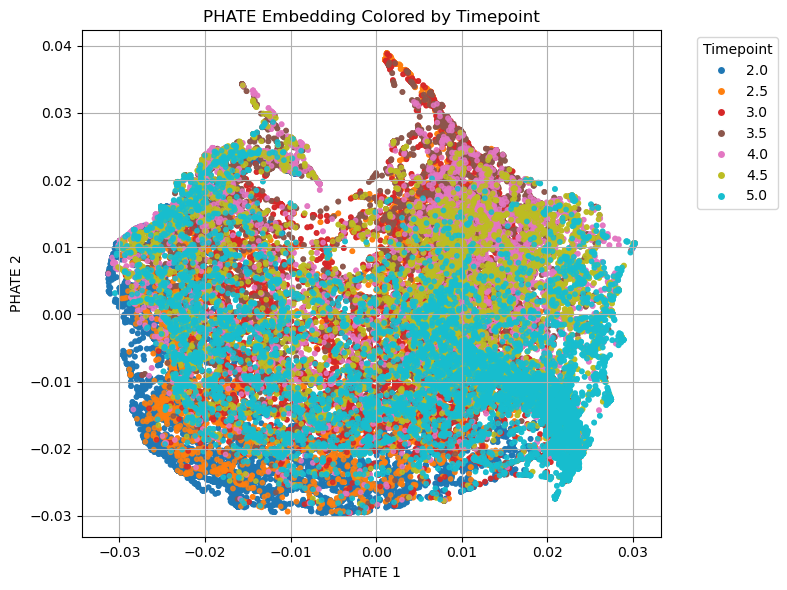

In [7]:
# Extract labels from the 'timepoint' column
labels = combined_equal_data['timepoint'].values

# If timepoint is categorical or string, convert to numerical codes
label_categories = pd.Categorical(labels)
color_codes = label_categories.codes  # For coloring
unique_labels = label_categories.categories  # For legend

# Plot
plt.figure(figsize=(8, 6))
scatter = plt.scatter(
    data_phate[:, 0], data_phate[:, 1],
    c=color_codes,
    cmap='tab10',
    s=10,
    alpha=0.8
)

scatter = plt.scatter(
    data_phate[:, 0], data_phate[:, 1],
    c=color_codes,
    cmap='tab10',
    s=10,
    alpha=0.8
)

# Legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w',
           label=label,
           markerfacecolor=scatter.cmap(i / max(1, len(unique_labels) - 1)),
           markersize=6)
    for i, label in enumerate(unique_labels)
]
plt.legend(handles=legend_elements, title="Timepoint", bbox_to_anchor=(1.05, 1), loc='upper left')

plt.title("PHATE Embedding Colored by Timepoint")
plt.xlabel("PHATE 1")
plt.ylabel("PHATE 2")
plt.grid(True)
plt.tight_layout()
plt.show()

#each timepoint as a separate plot
#run it in synthetic data

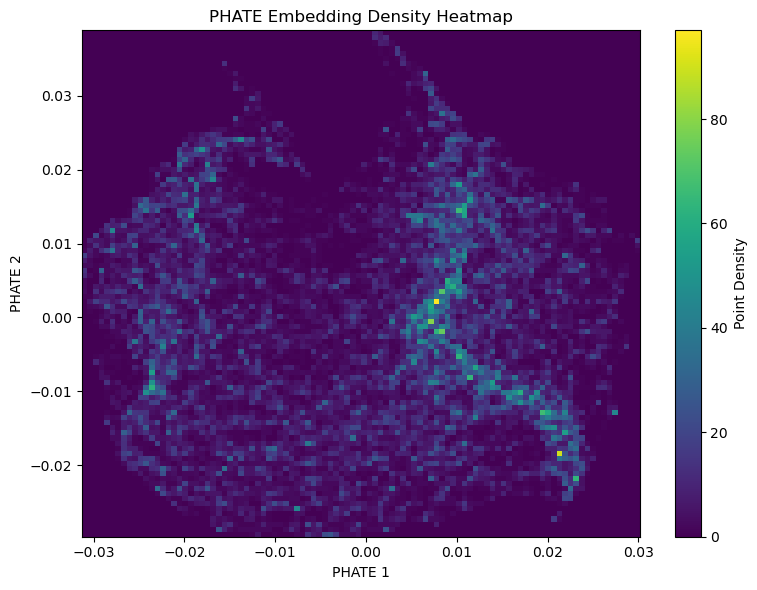

In [8]:
plt.figure(figsize=(8, 6))
plt.hist2d(data_phate[:, 0], data_phate[:, 1], bins=100, cmap='viridis')

plt.colorbar(label='Point Density')
plt.title("PHATE Embedding Density Heatmap")
plt.xlabel("PHATE 1")
plt.ylabel("PHATE 2")
plt.grid(False)
plt.tight_layout()
plt.show()


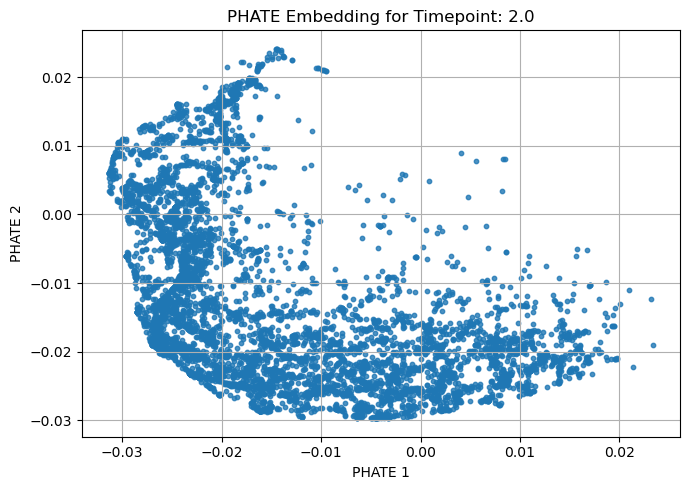

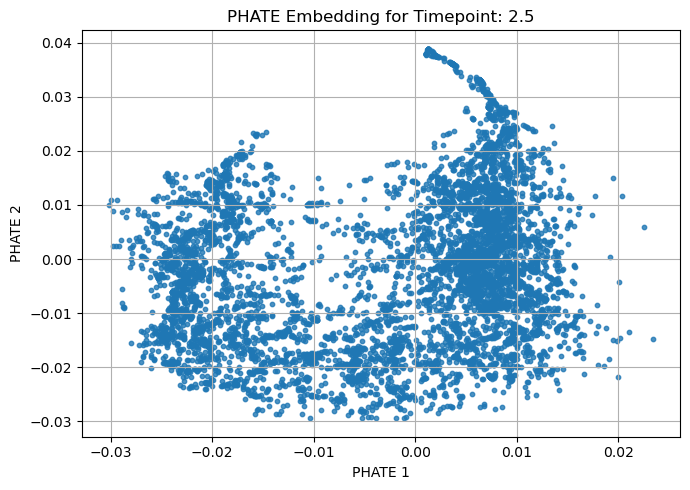

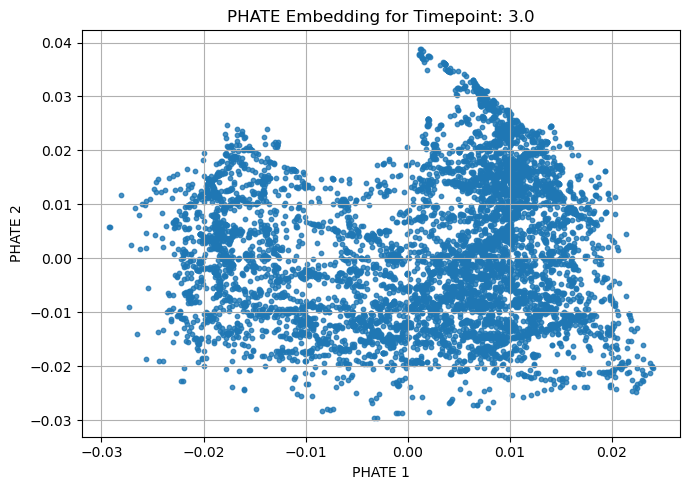

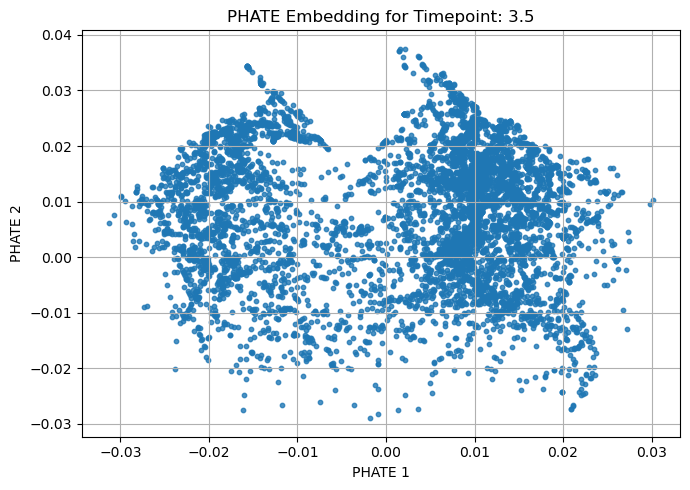

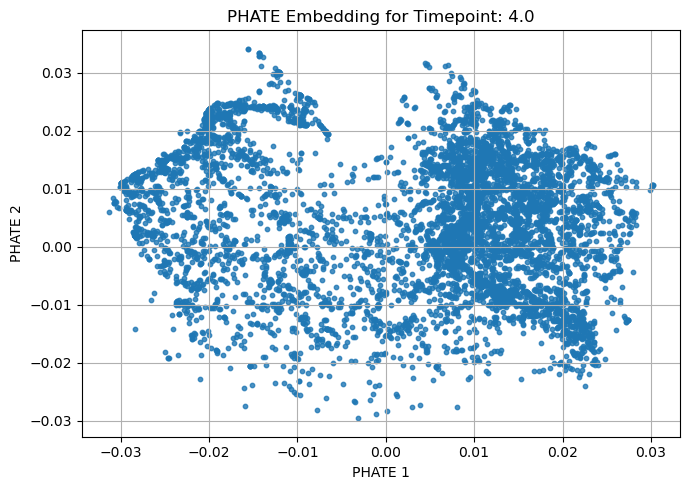

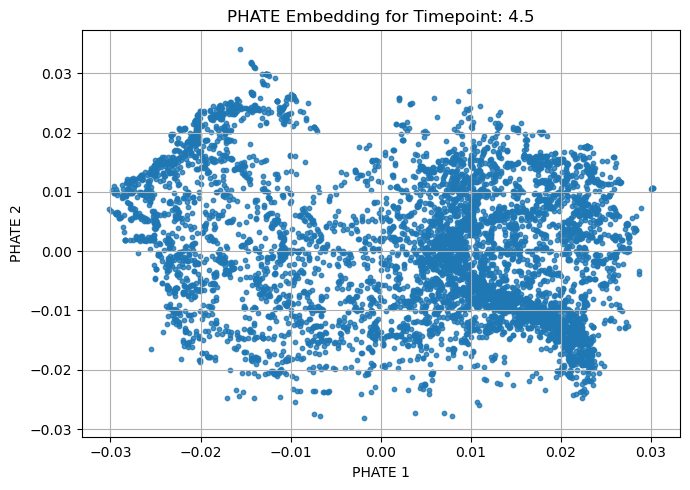

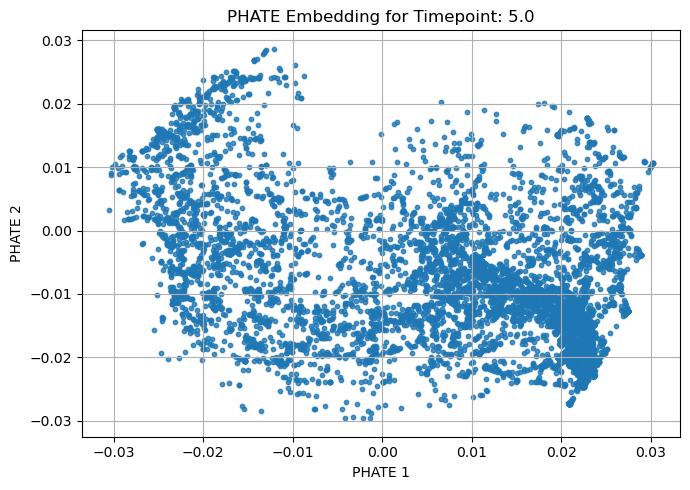

In [9]:
# Get unique timepoints
timepoints = combined_equal_data['timepoint'].unique()

# Loop through each timepoint and plot separately
for timepoint in timepoints:
    # Boolean mask to filter data
    mask = combined_equal_data['timepoint'] == timepoint
    phate_subset = data_phate[mask]

    # Plot
    plt.figure(figsize=(7, 5))
    plt.scatter(
        phate_subset[:, 0], phate_subset[:, 1],
        s=10,
        alpha=0.8,
        c='tab:blue'
    )
    plt.title(f"PHATE Embedding for Timepoint: {timepoint}")
    plt.xlabel("PHATE 1")
    plt.ylabel("PHATE 2")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


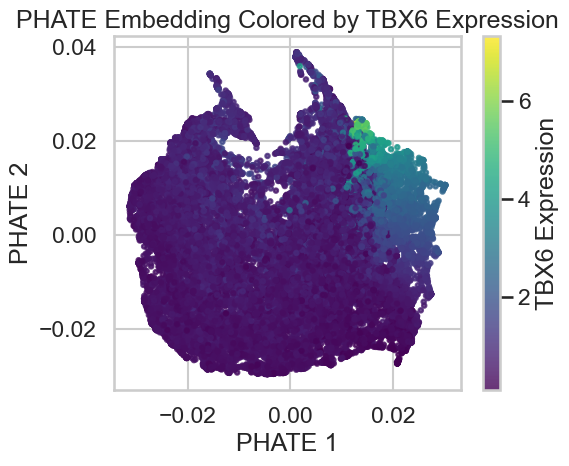

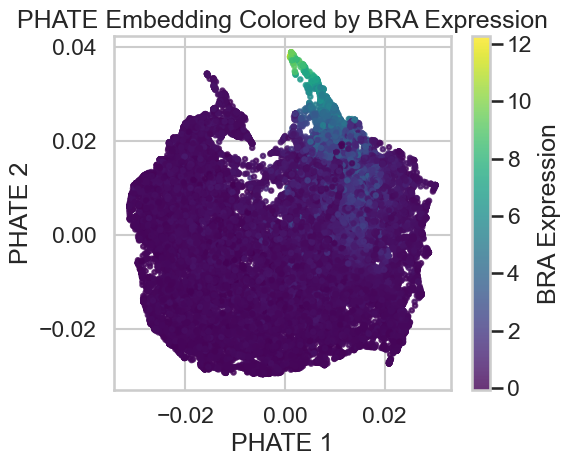

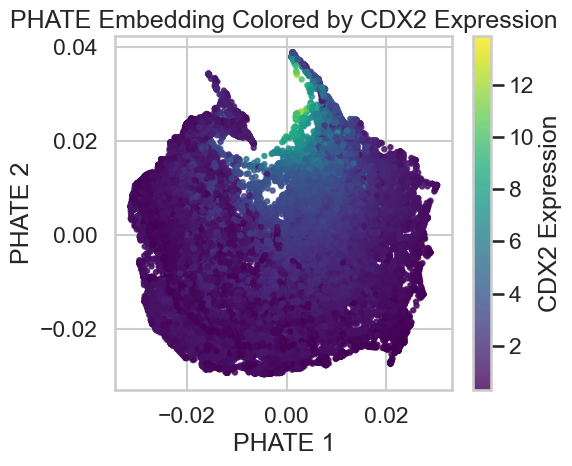

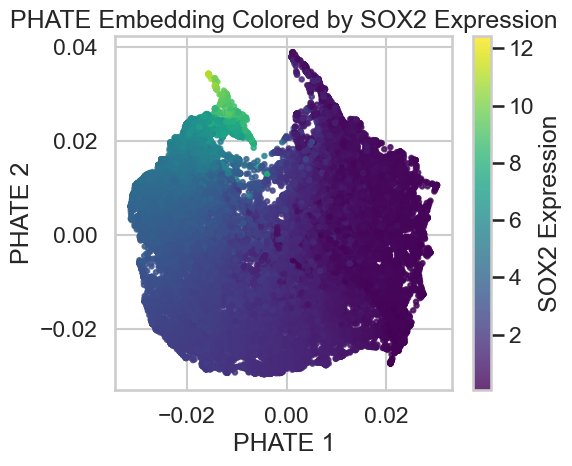

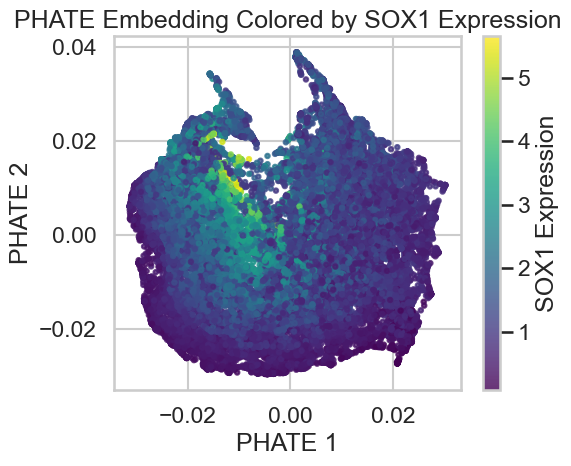

In [24]:
genes = ['TBX6', 'BRA', 'CDX2','SOX2', 'SOX1']  # Adjust to your actual gene names

for gene in genes:
    gene_expression = combined_equal_data[gene].values  # Continuous values

    plt.figure(figsize=(6, 5))
    scatter = plt.scatter(
        data_phate[:, 0], data_phate[:, 1],
        c=gene_expression,
        cmap='viridis',
        s=10,
        alpha=0.8
    )
    plt.colorbar(scatter, label=f'{gene} Expression')
    plt.title(f'PHATE Embedding Colored by {gene} Expression')
    plt.xlabel("PHATE 1")
    plt.ylabel("PHATE 2")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


/var/folders/n_/71k4tw3x1m3b_1yxyb68trv00000gn/T/ipykernel_4240/2698391852.py:38: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  scatter = plt.scatter(


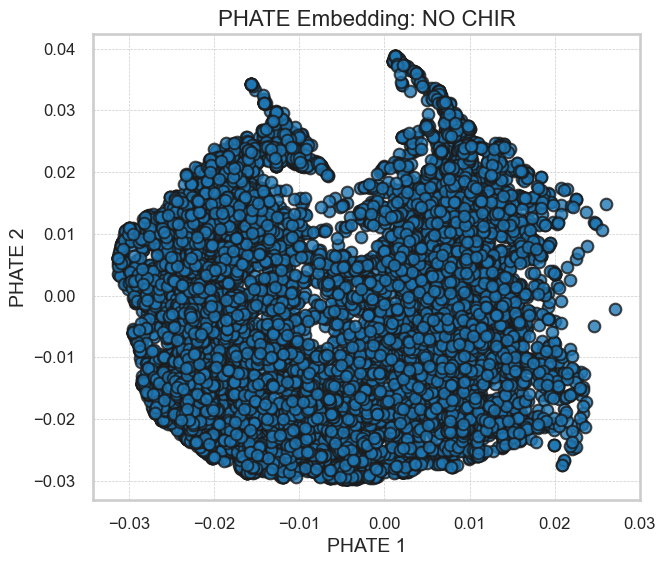

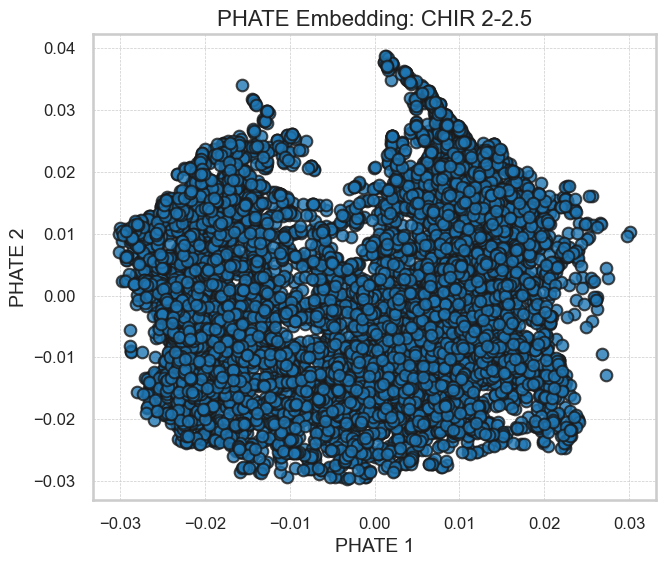

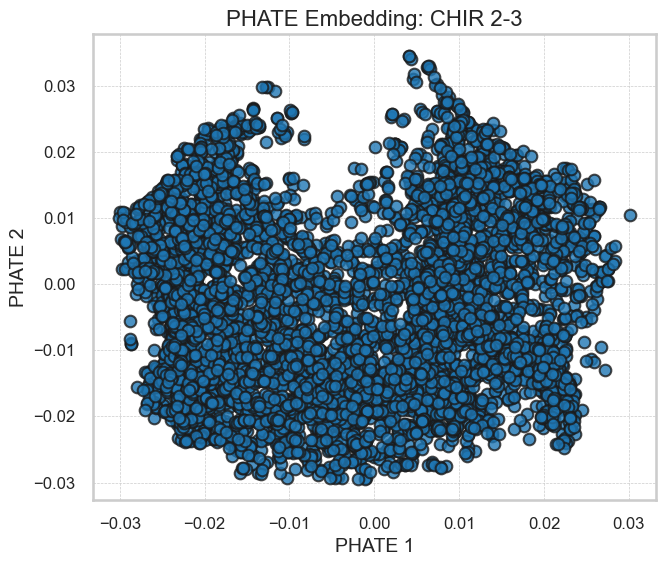

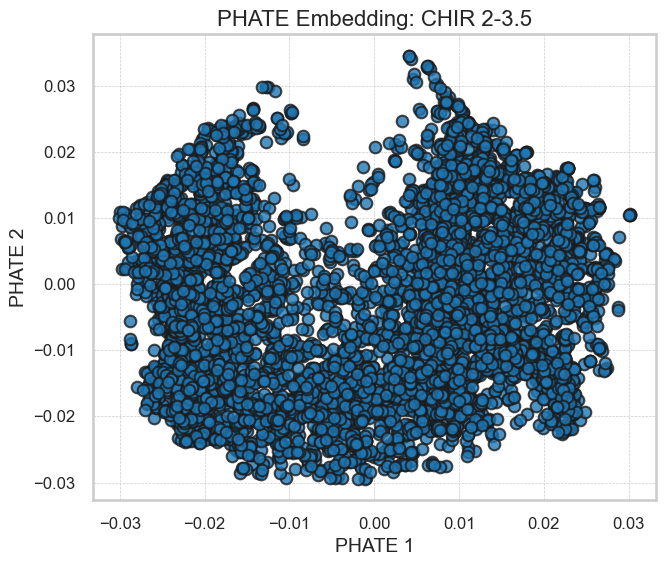

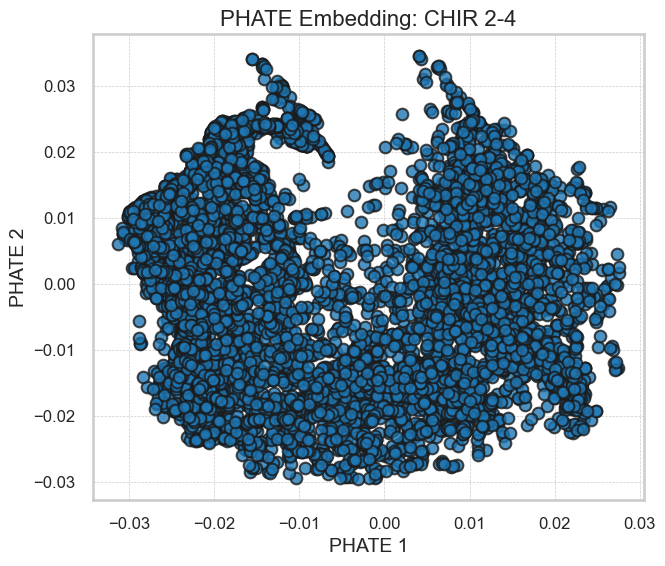

...

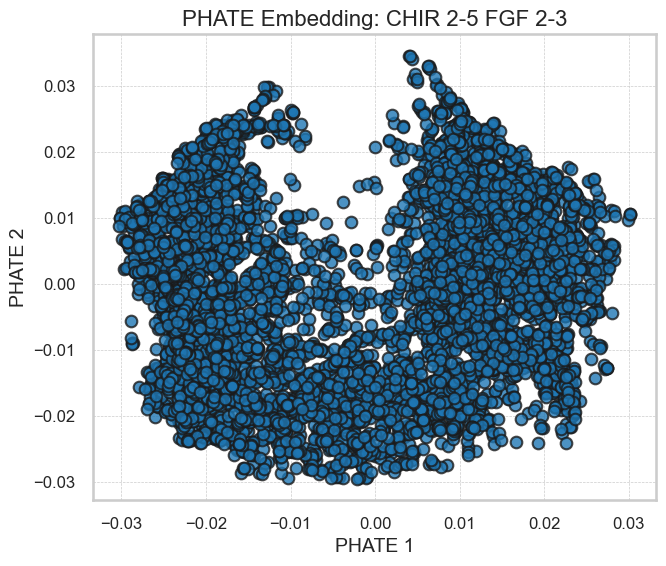

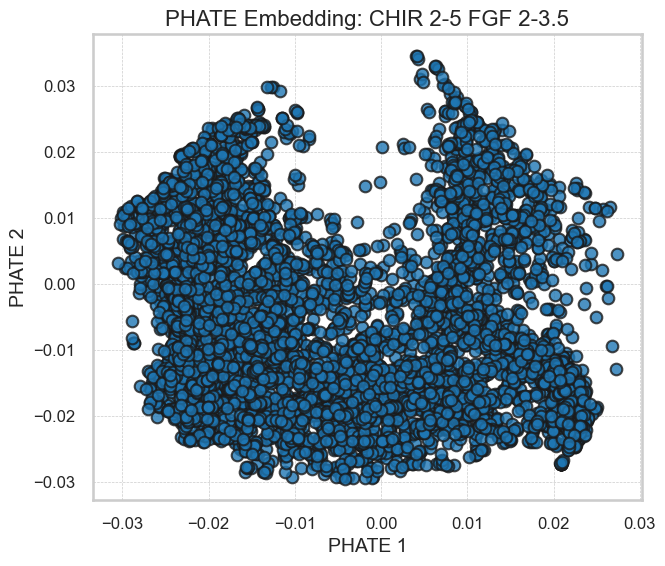

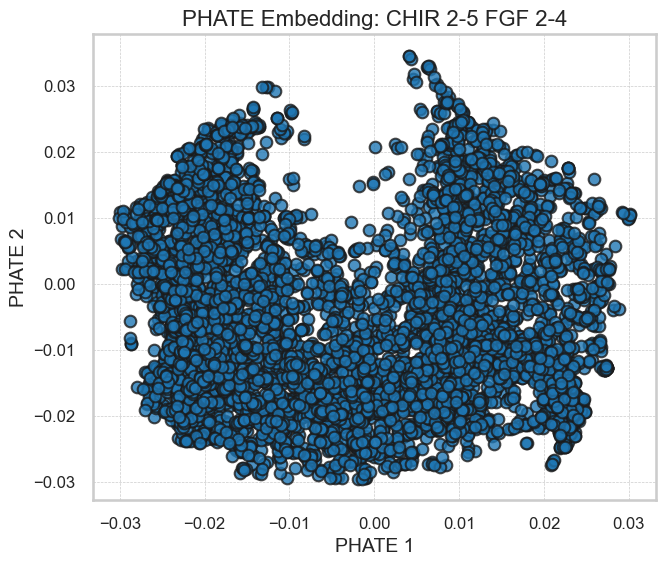

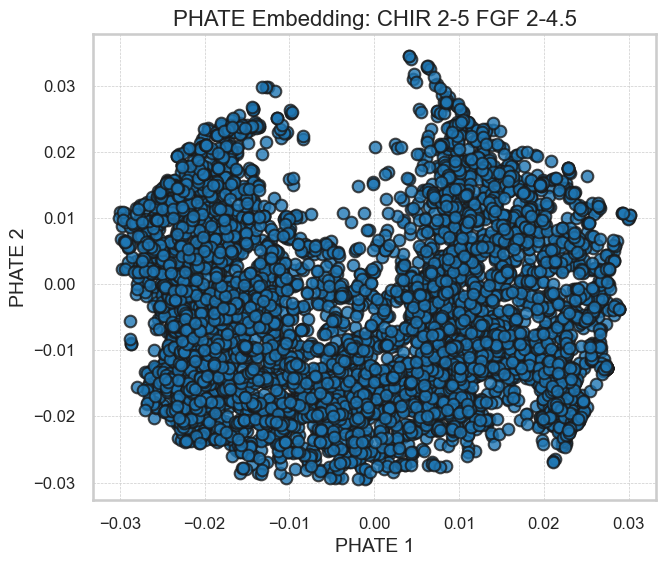

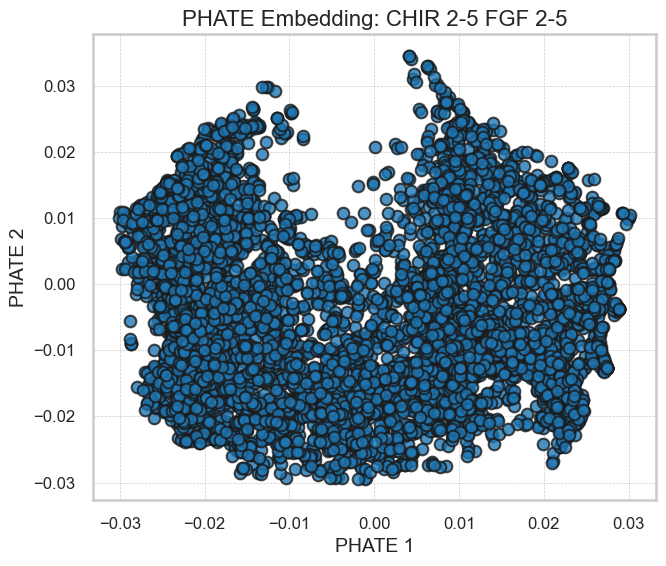

In [23]:
#Separating based on gene expression 

NO_CHIR = combined_equal_data['sample'].isin([0, 1, 2, 3, 4, 5, 6])
CHIR_2_2_5 = combined_equal_data['sample'].isin([0, 7, 8, 9, 10, 11, 12])
CHIR_2_3 = combined_equal_data['sample'].isin([0, 7, 13, 14, 15, 16, 17])
CHIR_2_3_5 = combined_equal_data['sample'].isin([0, 7, 13, 18, 19, 20, 21])
CHIR_2_4 = combined_equal_data['sample'].isin([0, 7, 13, 18, 22, 23, 24])
CHIR_2_5 = combined_equal_data['sample'].isin([0, 7, 13, 18, 22, 25, 26])
CHIR_2_5_FGF_2_3 = combined_equal_data['sample'].isin([0, 7, 13, 27, 28, 29, 30])
CHIR_2_5_FGF_2_3_5 = combined_equal_data['sample'].isin([0, 7, 13, 31, 32, 33, 34])
CHIR_2_5_FGF_2_4 = combined_equal_data['sample'].isin([0, 7, 13, 31, 35, 36, 37])
CHIR_2_5_FGF_2_4_5 = combined_equal_data['sample'].isin([0, 7, 13, 31, 35, 38, 39])
CHIR_2_5_FGF_2_5 = combined_equal_data['sample'].isin([0, 7, 13, 31, 35, 38, 40])

# Set a professional style globally
sns.set(style="whitegrid", context="talk")

# Dictionary to keep track of subset names for clearer titles
subset_dict = {
    "NO CHIR": NO_CHIR,
    "CHIR 2-2.5": CHIR_2_2_5,
    "CHIR 2-3": CHIR_2_3,
    "CHIR 2-3.5": CHIR_2_3_5,
    "CHIR 2-4": CHIR_2_4,
    "CHIR 2_5": CHIR_2_5,
    "CHIR 2-5 FGF 2-3": CHIR_2_5_FGF_2_3,
    "CHIR 2-5 FGF 2-3.5": CHIR_2_5_FGF_2_3_5,
    "CHIR 2-5 FGF 2-4": CHIR_2_5_FGF_2_4,
    "CHIR 2-5 FGF_2-4.5": CHIR_2_5_FGF_2_4_5,
    "CHIR 2-5 FGF 2-5": CHIR_2_5_FGF_2_5
}

# Loop with named subsets for better titles
for name, subset in subset_dict.items():
    phate_subset = data_phate[subset]

    plt.figure(figsize=(7, 6))
    scatter = plt.scatter(
        phate_subset[:, 0], phate_subset[:, 1],
        c=sns.color_palette("tab10")[0],  # Use a consistent professional color
        edgecolor='k',
        s=70,
        alpha=0.8
    )
    plt.title(f"PHATE Embedding: {name.replace('_', ' ')}", fontsize=16)
    plt.xlabel("PHATE 1", fontsize=14)
    plt.ylabel("PHATE 2", fontsize=14)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.grid(True, linestyle='--', linewidth=0.5)
    plt.tight_layout()
    plt.show()
        


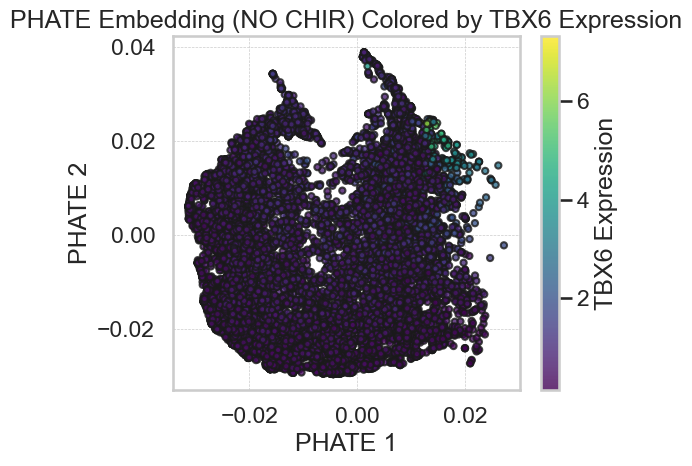

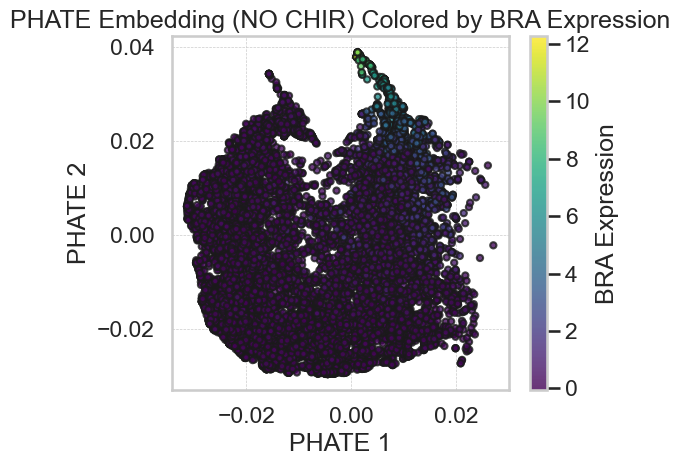

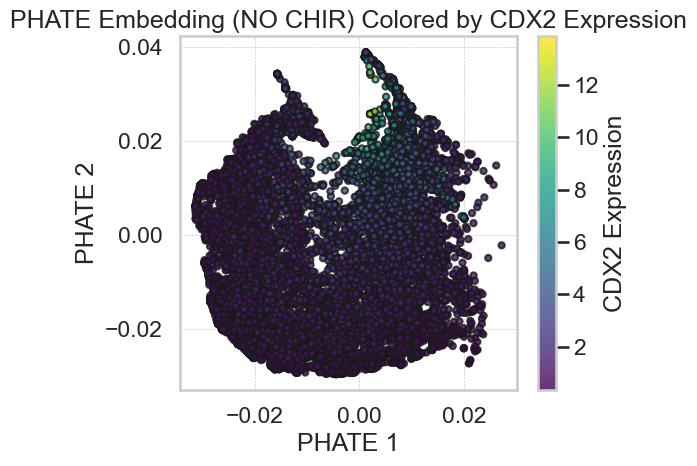

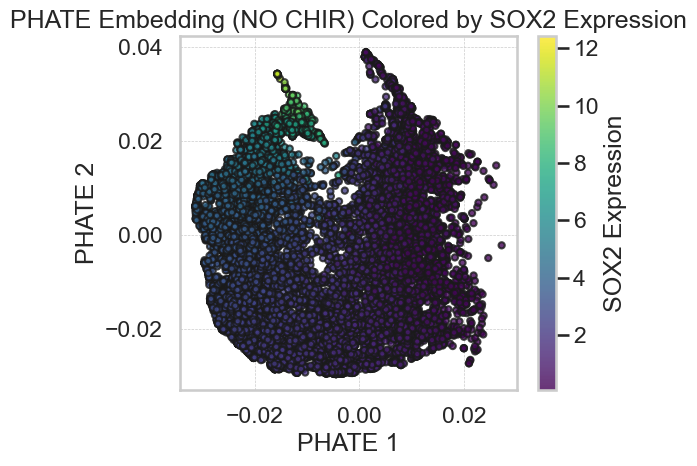

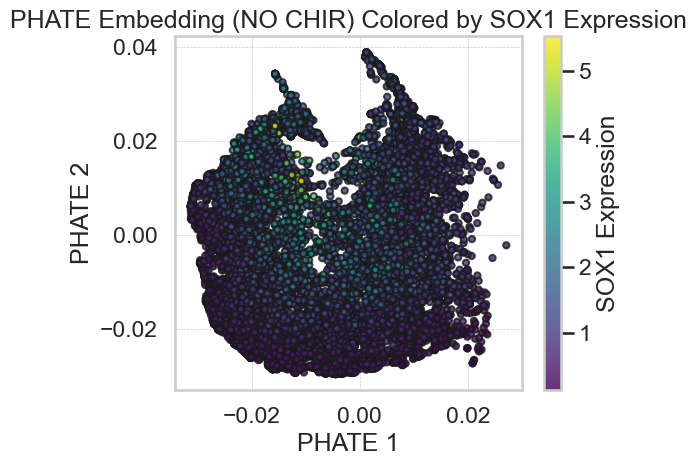

In [26]:
genes = ['TBX6', 'BRA', 'CDX2', 'SOX2', 'SOX1']

for gene in genes:
    # Subset both PHATE and gene expression values for the same group
    phate_subset = data_phate[NO_CHIR]
    gene_expression_subset = combined_equal_data[gene].values[NO_CHIR]

    plt.figure(figsize=(6, 5))
    scatter = plt.scatter(
        phate_subset[:, 0], phate_subset[:, 1],
        c=gene_expression_subset,
        cmap='viridis',
        s=20,
        alpha=0.8,
        edgecolor='k'
    )
    plt.colorbar(scatter, label=f'{gene} Expression')
    plt.title(f'PHATE Embedding (NO CHIR) Colored by {gene} Expression')
    plt.xlabel("PHATE 1")
    plt.ylabel("PHATE 2")
    plt.grid(True, linestyle='--', linewidth=0.5)
    plt.tight_layout()
    plt.show()


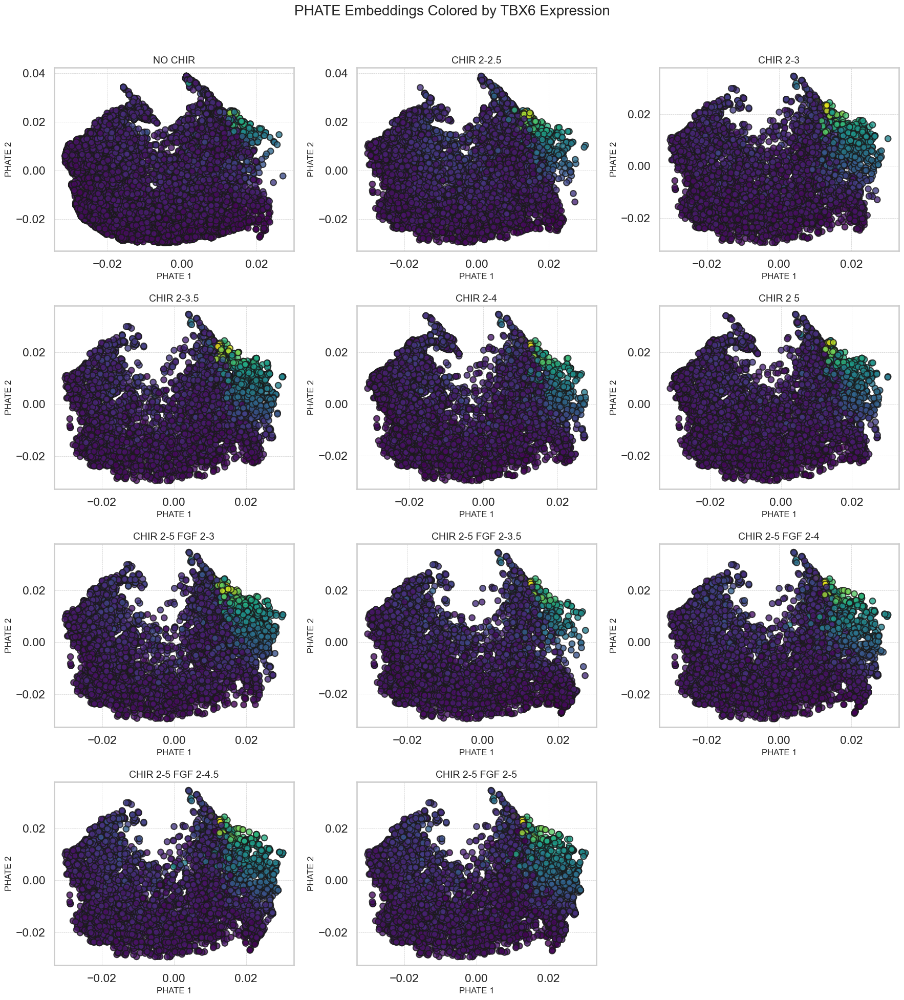

In [45]:
# Set up the subplot grid: 4 rows × 3 columns
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(18, 20))
axes = axes.flatten()  # Flatten for easy indexing

# Loop through all subset names and masks
for idx, (name, subset) in enumerate(subset_dict.items()):
    if idx >= len(axes):
        break  # Avoid going out of bounds if fewer than 12 subsets

    ax = axes[idx]
    phate_subset = data_phate[subset]
    gene_expression_subset = combined_equal_data['TBX6'].values[subset]

    scatter = ax.scatter(
        phate_subset[:, 0], phate_subset[:, 1],
        c=gene_expression_subset,
        cmap='viridis',
        edgecolor='k',
        s=70,
        alpha=0.8
    )
    ax.set_title(f"{name.replace('_', ' ')}", fontsize=14)
    ax.set_xlabel("PHATE 1", fontsize=12)
    ax.set_ylabel("PHATE 2", fontsize=12)
    ax.grid(True, linestyle='--', linewidth=0.5)

    # Optional: add individual colorbars (remove comment if needed)
    # fig.colorbar(scatter, ax=ax, orientation='vertical', shrink=0.7)

# Hide any unused axes
for j in range(idx + 1, len(axes)):
    fig.delaxes(axes[j])

fig.suptitle("PHATE Embeddings Colored by TBX6 Expression", fontsize=20)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()


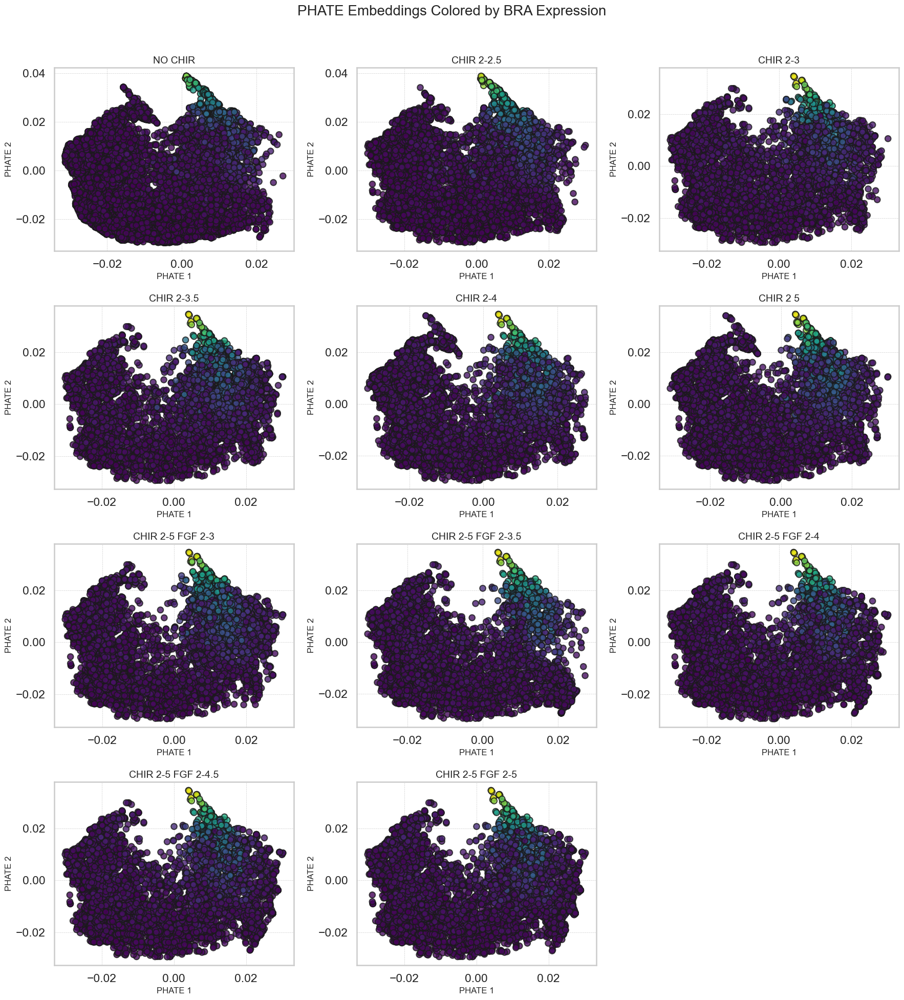

In [39]:
# Set up the subplot grid
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(18, 20))
axes = axes.flatten()  # Make it easier to loop through

# Loop through all subset names and masks
for idx, (name, subset) in enumerate(subset_dict.items()):
    if idx >= len(axes):
        break  # Prevent indexing error if there are more subsets than subplots

    ax = axes[idx]
    phate_subset = data_phate[subset]
    gene_expression_subset = combined_equal_data['BRA'].values[subset]

    scatter = ax.scatter(
        phate_subset[:, 0], phate_subset[:, 1],
        c=gene_expression_subset,
        cmap='viridis',
        edgecolor='k',
        s=70,
        alpha=0.8
    )
    ax.set_title(f"{name.replace('_', ' ')}", fontsize=14)
    ax.set_xlabel("PHATE 1", fontsize=12)
    ax.set_ylabel("PHATE 2", fontsize=12)
    ax.grid(True, linestyle='--', linewidth=0.5)

    # Optional: add a colorbar next to each plot (advanced) or skip for clarity
    # fig.colorbar(scatter, ax=ax, orientation='vertical', shrink=0.7)

# Hide any unused axes
for j in range(idx + 1, len(axes)):
    fig.delaxes(axes[j])

fig.suptitle("PHATE Embeddings Colored by BRA Expression", fontsize=20)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()


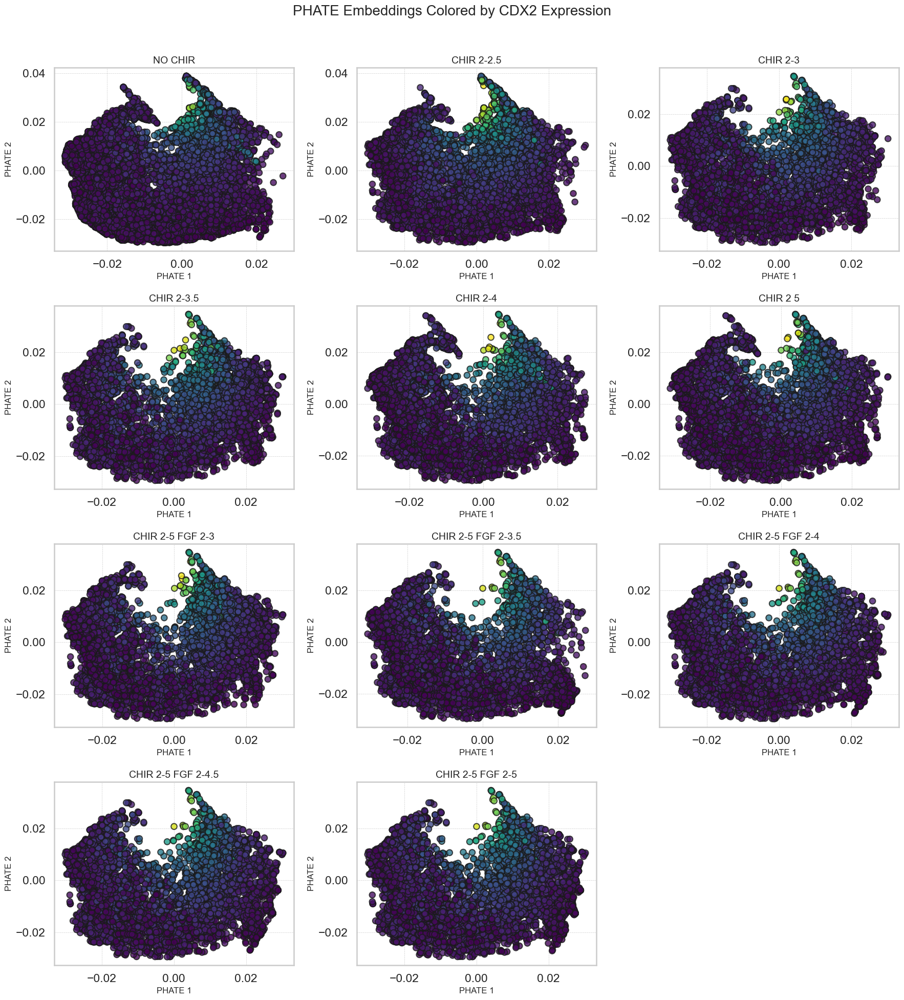

In [41]:
# Set up the subplot grid: 4 rows × 3 columns
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(18, 20))
axes = axes.flatten()  # Flatten for easy indexing

# Loop through all subset names and masks
for idx, (name, subset) in enumerate(subset_dict.items()):
    if idx >= len(axes):
        break  # Avoid going out of bounds if fewer than 12 subsets

    ax = axes[idx]
    phate_subset = data_phate[subset]
    gene_expression_subset = combined_equal_data['CDX2'].values[subset]

    scatter = ax.scatter(
        phate_subset[:, 0], phate_subset[:, 1],
        c=gene_expression_subset,
        cmap='viridis',
        edgecolor='k',
        s=70,
        alpha=0.8
    )
    ax.set_title(f"{name.replace('_', ' ')}", fontsize=14)
    ax.set_xlabel("PHATE 1", fontsize=12)
    ax.set_ylabel("PHATE 2", fontsize=12)
    ax.grid(True, linestyle='--', linewidth=0.5)

    # Optional: add individual colorbars (remove comment if needed)
    # fig.colorbar(scatter, ax=ax, orientation='vertical', shrink=0.7)

# Hide any unused axes
for j in range(idx + 1, len(axes)):
    fig.delaxes(axes[j])

fig.suptitle("PHATE Embeddings Colored by CDX2 Expression", fontsize=20)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

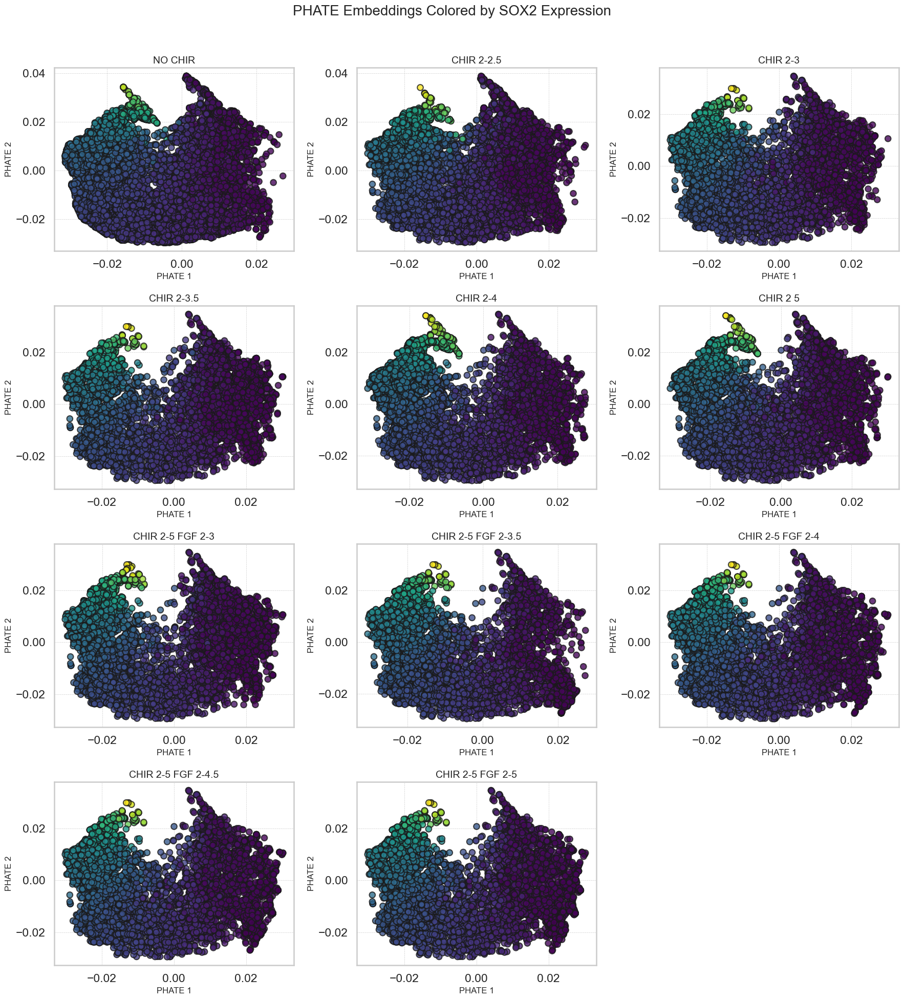

In [42]:
# Set up the subplot grid: 4 rows × 3 columns
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(18, 20))
axes = axes.flatten()  # Flatten for easy indexing

# Loop through all subset names and masks
for idx, (name, subset) in enumerate(subset_dict.items()):
    if idx >= len(axes):
        break  # Avoid going out of bounds if fewer than 12 subsets

    ax = axes[idx]
    phate_subset = data_phate[subset]
    gene_expression_subset = combined_equal_data['SOX2'].values[subset]

    scatter = ax.scatter(
        phate_subset[:, 0], phate_subset[:, 1],
        c=gene_expression_subset,
        cmap='viridis',
        edgecolor='k',
        s=70,
        alpha=0.8
    )
    ax.set_title(f"{name.replace('_', ' ')}", fontsize=14)
    ax.set_xlabel("PHATE 1", fontsize=12)
    ax.set_ylabel("PHATE 2", fontsize=12)
    ax.grid(True, linestyle='--', linewidth=0.5)

    # Optional: add individual colorbars (remove comment if needed)
    # fig.colorbar(scatter, ax=ax, orientation='vertical', shrink=0.7)

# Hide any unused axes
for j in range(idx + 1, len(axes)):
    fig.delaxes(axes[j])

fig.suptitle("PHATE Embeddings Colored by SOX2 Expression", fontsize=20)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

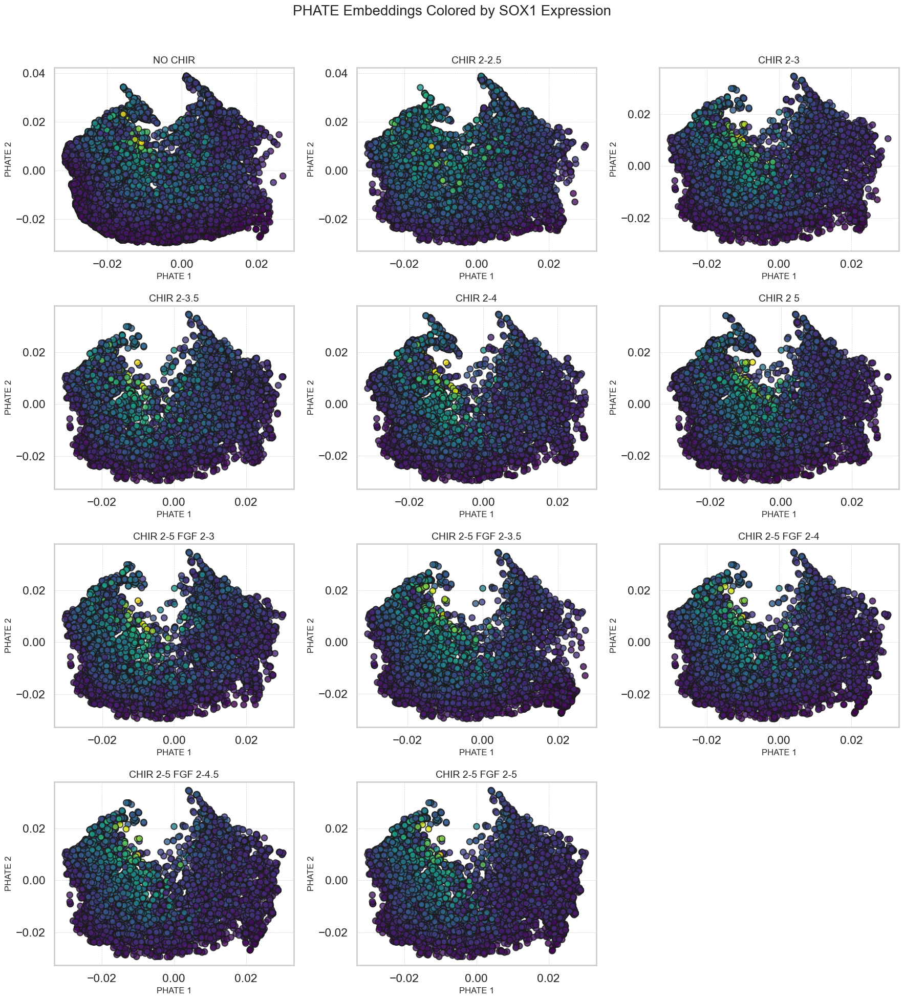

In [43]:
# Set up the subplot grid: 4 rows × 3 columns
fig, axes = plt.subplots(nrows=4, ncols=3, figsize=(18, 20))
axes = axes.flatten()  # Flatten for easy indexing

# Loop through all subset names and masks
for idx, (name, subset) in enumerate(subset_dict.items()):
    if idx >= len(axes):
        break  # Avoid going out of bounds if fewer than 12 subsets

    ax = axes[idx]
    phate_subset = data_phate[subset]
    gene_expression_subset = combined_equal_data['SOX1'].values[subset]

    scatter = ax.scatter(
        phate_subset[:, 0], phate_subset[:, 1],
        c=gene_expression_subset,
        cmap='viridis',
        edgecolor='k',
        s=70,
        alpha=0.8
    )
    ax.set_title(f"{name.replace('_', ' ')}", fontsize=14)
    ax.set_xlabel("PHATE 1", fontsize=12)
    ax.set_ylabel("PHATE 2", fontsize=12)
    ax.grid(True, linestyle='--', linewidth=0.5)

    # Optional: add individual colorbars (remove comment if needed)
    # fig.colorbar(scatter, ax=ax, orientation='vertical', shrink=0.7)

# Hide any unused axes
for j in range(idx + 1, len(axes)):
    fig.delaxes(axes[j])

fig.suptitle("PHATE Embeddings Colored by SOX1 Expression", fontsize=20)
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()